In [ ]:
!nvidia-smi -L

GPU 0: NVIDIA A100-SXM4-40GB (UUID: GPU-29a76f4e-a9e1-e408-f9d4-cd576d552e27)


In [ ]:
from google.colab import files
files.upload()

In [ ]:
!rm -rf ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c vk-made-ocr

100% 1.08G/1.08G [00:50<00:00, 19.3MB/s]
100% 1.08G/1.08G [00:50<00:00, 22.8MB/s]


In [ ]:
!mkdir -p dataset
!unzip -q vk-made-ocr.zip -d dataset
!rm vk-made-ocr.zip

# Imports

In [ ]:
!pip install pytorch_lightning==1.6.5
!pip install torch==1.11.0+cu113 torchvision==0.12.0+cu113 torchaudio==0.11.0 torchtext==0.12.0 torchdata==0.3.0 --extra-index-url https://download.pytorch.org/whl/cu113
!pip install timm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 585.9/585.9 kB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 48.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 70.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 16.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 33.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 22.3 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.3
    Uninstalling protobuf-3.20.3:
      Successfully uninstalled protobuf-3.20.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
g

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/, https://download.pytorch.org/whl/cu113
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 GB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.3/22.3 MB 44.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 38.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 84.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.7/47.7 kB 7.1 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 2.0.1+cu118
    Uninstalling torch-2.0.1+cu118:
      Successfully uninstalled torch-2.0.1+cu118
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.15.2+cu118
    Uninstalling torchvision-0.15.2+cu118:
      Successfully uninstalled torchvision-0.15.2+cu118
  Attempting uninstall: torchtext
    Found existing installation: torchtext 0.15.2
    Uninstalling to

In [ ]:
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random
import cv2
import albumentations as A
import torch
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from albumentations.pytorch import ToTensorV2
from tqdm.notebook import tqdm
from torch.nn import Module, Sequential, Conv2d, AdaptiveAvgPool2d, GRU, Linear, CTCLoss, Embedding
from torch.nn.functional import log_softmax
from torchvision import models
from nltk import edit_distance
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
import pytorch_lightning as pl
import os
from timm.optim import create_optimizer_v2
sns.set_theme(style="whitegrid")

In [ ]:
RANDOM_STATE = 123
BLANK_SYMBOL = 'ß'

In [ ]:
def plot_from_batch_generator(batch_gen, train_mean, train_std):
    data = next(iter(batch_gen))
    grid_size = (4, 4)
    f, axarr = plt.subplots(*grid_size)
    f.set_size_inches(15,10)
    for i in range(grid_size[0] * grid_size[1]):
        
        # read images from batch to numpy.ndarray and change axes order [H, W, C] -> [H, W, C]
        batch_image_ndarray = np.transpose(data['image'][i].numpy(), [1, 2, 0])
        
        # inverse normalization for image data values back to [0,1] and clipping the values for correct pyplot.imshow()
        src = np.clip(train_std * batch_image_ndarray + train_mean, 0, 1)
        
        # display batch samples with labels
        sample_title = f'{data["text"][i]}'
        axarr[i // grid_size[0], i % grid_size[0]].imshow(src)
        axarr[i // grid_size[0], i % grid_size[0]].set_title(sample_title)

In [ ]:
def calculate_mean_and_std(df):
    to_tensor = ToTensorV2()
    psum = torch.tensor([0.0, 0.0, 0.0])
    psum_sq = torch.tensor([0.0, 0.0, 0.0])
    count = 0
    for image in tqdm(df['Id']):
        image = cv2.imread(f'dataset/train/train/{image}').astype(np.float32) / 255.0
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        arr = to_tensor(image=image)["image"]
        psum += arr.sum(axis = [1, 2])
        psum_sq += (arr ** 2).sum(axis = [1, 2])
        count += arr.size()[1] * arr.size()[2]
    total_mean = psum / count
    total_var = (psum_sq / count) - (total_mean ** 2)
    total_std = torch.sqrt(total_var)
    return total_mean, total_std

In [ ]:
def filter_train_data(df, max_target_length, drop_undefined_language):
    filtered = df[df.target_length <= max_target_length].copy()
    if drop_undefined_language:
        return filtered[~filtered.language.eq('undefined')]
    return filtered

In [ ]:
class RecognitionDataset(Dataset):
    """Class for training image-to-text mapping using CTC-Loss."""

    def __init__(self, df, char2id, folder='dataset/train/train', transforms=None):
        """Constructor for class.
        
        Args:
            - config: pandas dataframe with Id, Expected and other columns.
            - alphabet: String of chars required for predicting.
            - transforms: Transformation for items, should accept and return dict with keys "image", "seq", "seq_len" & "text".
        """
        super(RecognitionDataset, self).__init__()
        self.df = df
        self.image_names = df['Id'].to_list()
        self.texts = df['Expected'].to_list()
        self.transforms = transforms
        self.char2id = char2id
        self.folder = folder

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, item):
        """Returns dict with keys "image", "seq", "seq_len" & "text".
        Seq is list of integers.
        Seq_len is an integer.
        Text is a string.
        """
        image = cv2.imread(f'{self.folder}/{self.image_names[item]}')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        if self.transforms is not None:
            image = self.transforms(image=image)["image"]
        text = str(self.texts[item])
        seq = [self.char2id[c] for c in text if c in self.char2id]
        seq_len = len(seq)
        output = dict(image=image, seq=seq, seq_len=seq_len, text=text)
        return output

In [ ]:
def collate_fn(batch):
    """Function for torch.utils.data.Dataloader for batch collecting.
    
    Args:
        - batch: List of dataset __getitem__ return values (dicts).
        
    Returns:
        Dict with same keys but values are either torch.Tensors of batched images or sequences or so.
    """
    images, seqs, seq_lens, texts = [], [], [], []
    for item in batch:
        images.append(item["image"])
        seqs.extend(item["seq"])
        seq_lens.append(item["seq_len"])
        texts.append(item["text"])
    images = torch.stack(images)
    seqs = torch.Tensor(seqs).int()
    seq_lens = torch.Tensor(seq_lens).int()
    batch = {"image": images, "seq": seqs, "seq_len": seq_lens, "text": texts}
    return batch

In [ ]:
def pred_to_string(pred, id2char, blank_id=0):
    seq = []
    for i in range(len(pred)):
        seq.append(np.argmax(pred[i]))
    out = []
    for i in range(len(seq)):
        if len(out) == 0:
            if seq[i] != blank_id:
                out.append(seq[i])
        else:
            if seq[i] != blank_id and seq[i] != seq[i - 1]:
                out.append(seq[i])
    out = ''.join([id2char[c] for c in out])
    return out

def decode(pred, id2char):
    pred = pred.permute(1, 0, 2).cpu().data.numpy()
    outputs = []
    for i in range(len(pred)):
        outputs.append(pred_to_string(pred[i], id2char))
    return outputs

# Data Exploration

In [ ]:
!pip install lingua-language-detector
from lingua import Language, LanguageDetectorBuilder

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 MB 20.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 90.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.24.3 which is incompatible.
tensorflow 2.12.0 requires numpy<1.24,>=1.22, but you have numpy 1.24.3 which is incompatible.
tensorflow 2.12.0 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 3.20.1 which is incompatible.


In [ ]:
train_df = pd.read_csv('dataset/train_labels.csv')
train_df.head()

,Id,Expected
0,1.jpg,Атырау
1,2.jpg,транз
2,3.jpg,ходят
3,4.jpg,"ощущений,"
4,5.jpg,74


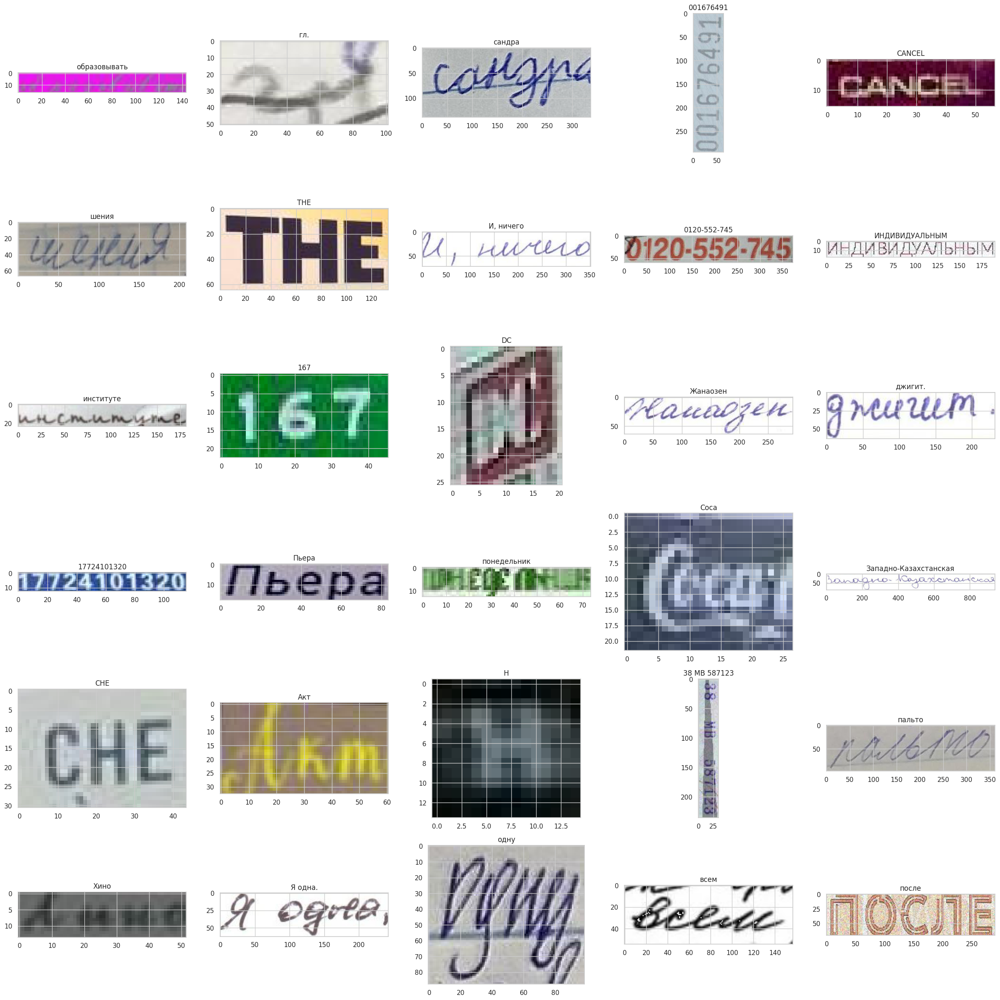

In [ ]:
f, ax = plt.subplots(6, 5, figsize=(30, 30))
for idx, row in enumerate(train_df.sample(30, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(row.Expected)
plt.show()

In [ ]:
train_df['target_length'] = train_df['Expected'].apply(lambda x: len(str(x)))

<Axes: xlabel='target_length', ylabel='Count'>

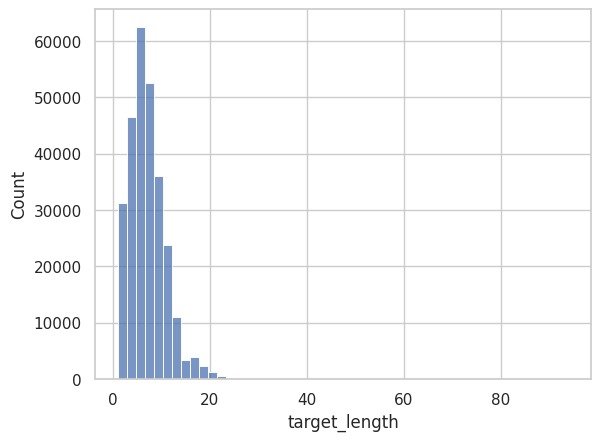

In [ ]:
sns.histplot(data=train_df, x="target_length", bins=50)

In [ ]:
print(f'samples with length more than 25: {(train_df["target_length"] > 25).sum() / len(train_df) * 100:.2f}%')

samples with length more than 25: 0.33%


In [ ]:
thresholds = list(range(train_df["target_length"].min(), train_df["target_length"].max(), 3))

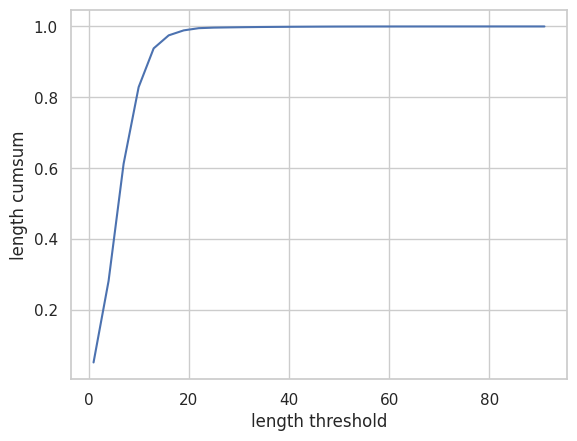

In [ ]:
plt.plot(thresholds, [(train_df["target_length"] <= threshold).sum() / len(train_df) for threshold in thresholds])
plt.xlabel('length threshold')
plt.ylabel('length cumsum')
plt.show()

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65292 (\N{FULLWIDTH COMMA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


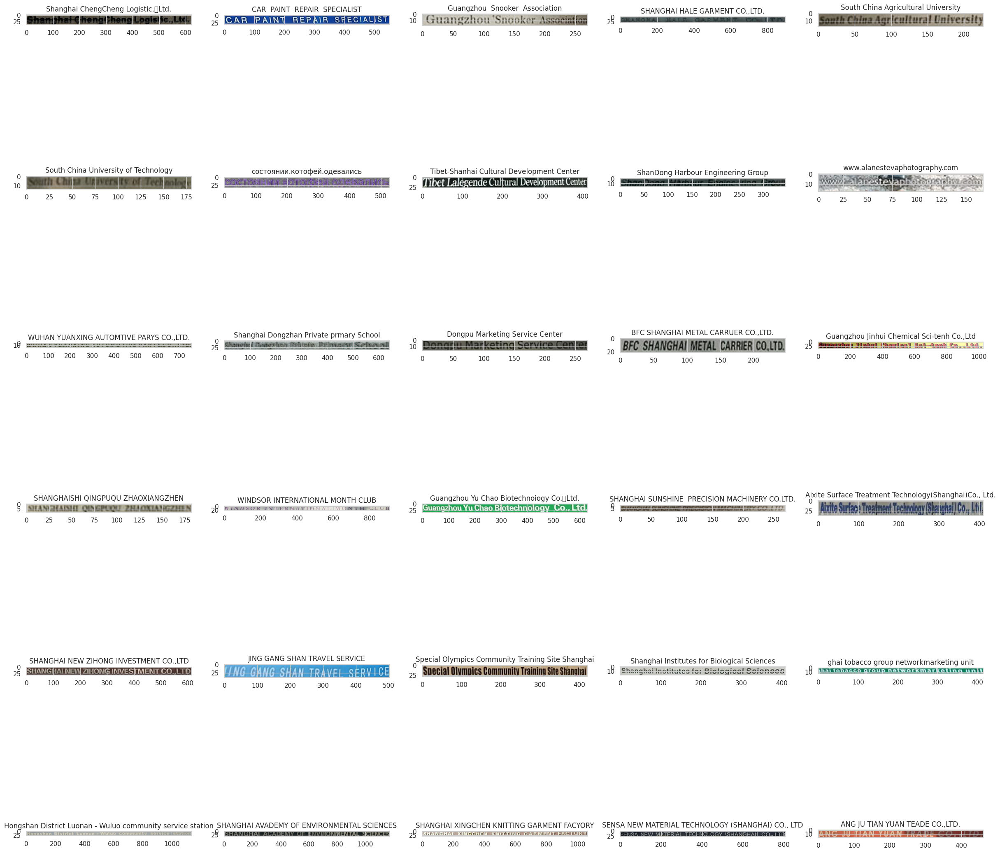

In [ ]:
f, ax = plt.subplots(6, 5, figsize=(30, 30))
for idx, row in enumerate(train_df[train_df.target_length > 25].sample(30).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(row.Expected)
plt.show()

In [ ]:
languages = [Language.ENGLISH, Language.RUSSIAN]
detector = LanguageDetectorBuilder.from_languages(*languages).build()

In [ ]:
def detect_language(text):
    if any(c.isalpha() for c in str(text)):
        detected = detector.detect_language_of(str(text))
        if detected is not None:
            return detected.name
        return 'undefined'
    else:
        return 'digits'

In [ ]:
train_df['language'] = train_df['Expected'].apply(detect_language)

<Axes: xlabel='language', ylabel='count'>

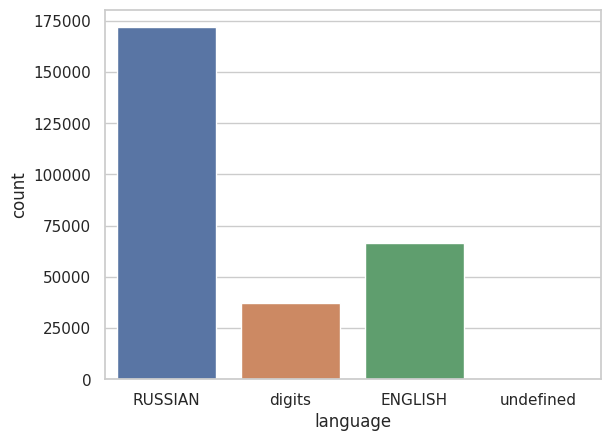

In [ ]:
sns.countplot(x=train_df["language"])

In [ ]:
def get_image_size(x):
    with Image.open(f'dataset/train/train/{x}') as im:
        return im.size

In [ ]:
def get_image_shape(shape):
    if shape[0] > shape[1] * 2:
        return 'horizontal rectangle'
    if shape[1] > shape[0] * 2:
        return 'vertical rectangle'
    else:
        return 'square'

In [ ]:
train_df['image_size'] = train_df['Id'].apply(get_image_size)

In [ ]:
train_df['image_shape'] = train_df['image_size'].apply(get_image_shape)

<Axes: xlabel='image_shape', ylabel='count'>

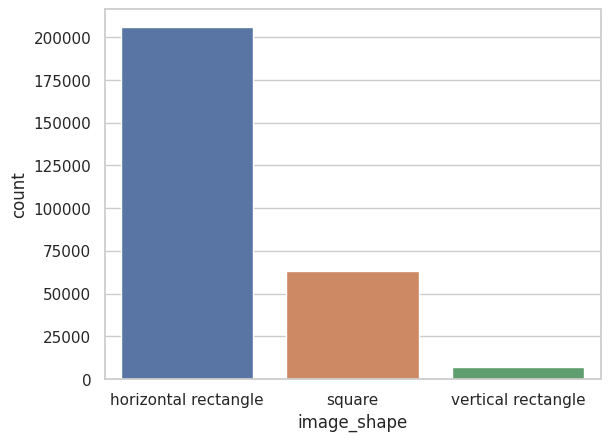

In [ ]:
sns.countplot(x=train_df["image_shape"])

[Text(0, 0, 'horizontal rectangle RUSSIAN'),
 Text(1, 0, 'square digits'),
 Text(2, 0, 'square ENGLISH'),
 Text(3, 0, 'vertical rectangle RUSSIAN'),
 Text(4, 0, 'square RUSSIAN'),
 Text(5, 0, 'horizontal rectangle ENGLISH'),
 Text(6, 0, 'horizontal rectangle digits'),
 Text(7, 0, 'vertical rectangle digits'),
 Text(8, 0, 'vertical rectangle ENGLISH'),
 Text(9, 0, 'square undefined'),
 Text(10, 0, 'horizontal rectangle undefined')]

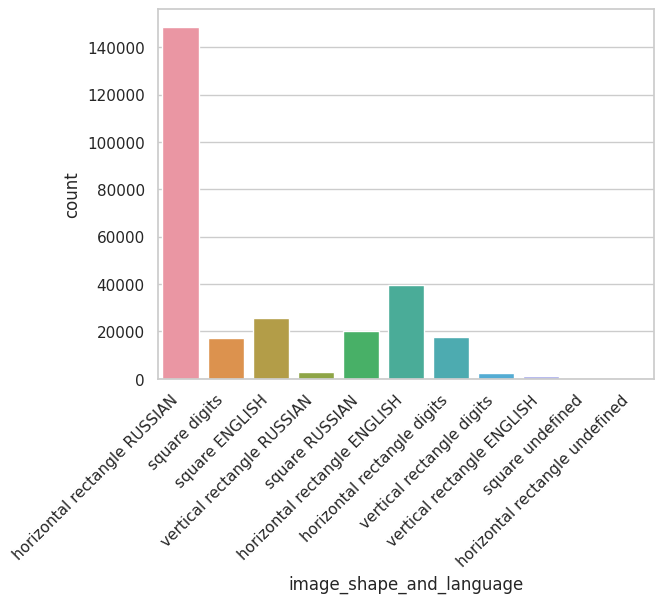

In [ ]:
train_df['image_shape_and_language'] = train_df["image_shape"] + ' ' + train_df["language"]
chart = sns.countplot(x=train_df["image_shape_and_language"])
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')

In [ ]:
image_shape_x = []
image_shape_y = []
for shape in train_df['image_size']:
    image_shape_x.append(shape[0])
    image_shape_y.append(shape[1])

print(f'average image shape: {int(sum(image_shape_x) / len(image_shape_x))}, {int(sum(image_shape_y) / len(image_shape_y))}')

average image shape: 189, 55


<Axes: ylabel='Count'>

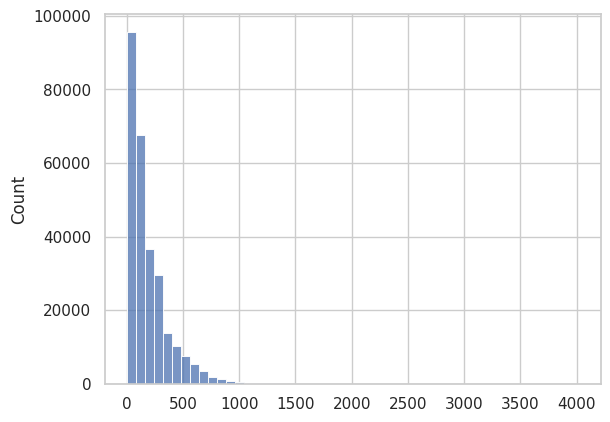

In [ ]:
sns.histplot(x=image_shape_x, bins=50)

<Axes: ylabel='Percent'>

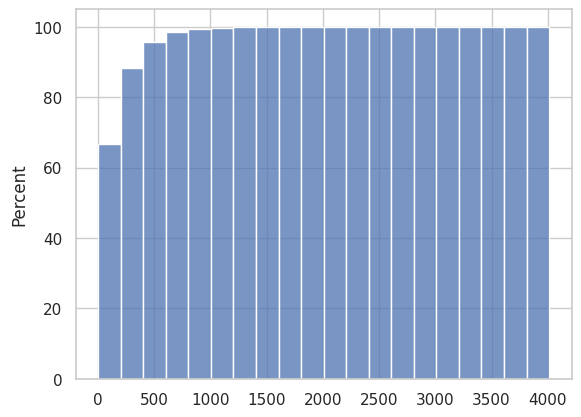

In [ ]:
sns.histplot(x=image_shape_x, bins=20, cumulative=True, stat='percent')

<Axes: ylabel='Count'>

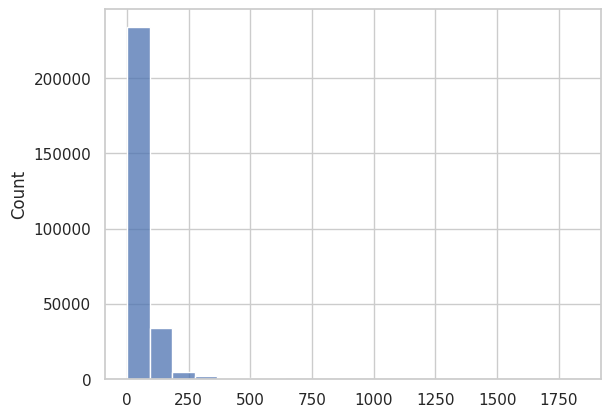

In [ ]:
sns.histplot(x=image_shape_y, bins=20)

<Axes: ylabel='Percent'>

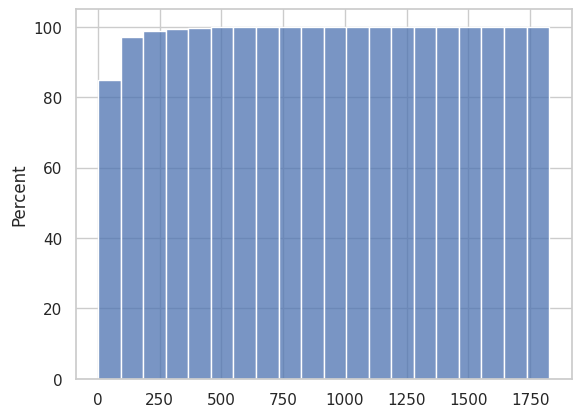

In [ ]:
sns.histplot(x=image_shape_y, bins=20, cumulative=True, stat='percent')

In [ ]:
print(f'samples with images smaller than 600x200: {sum([size[0] <= 600 and size[1] <= 200 for size in train_df["image_size"]]) / len(train_df) * 100:.2f}%')

samples with images smaller than 600x200: 94.06%


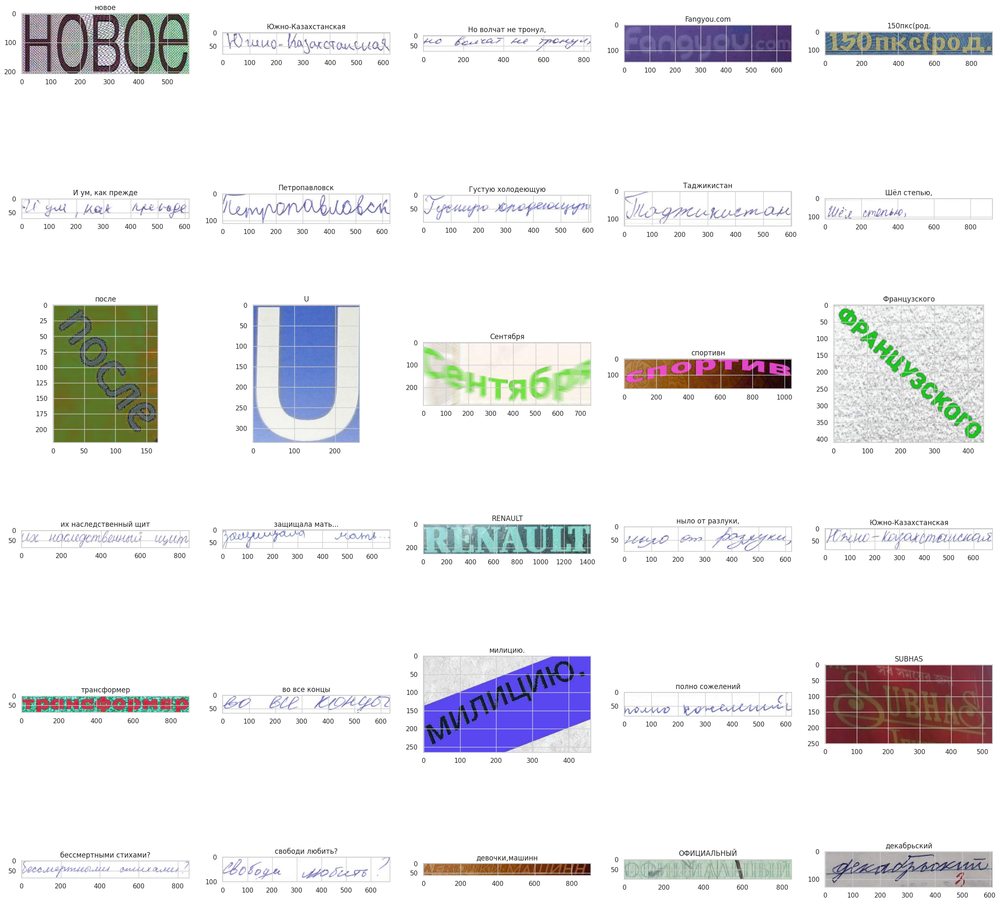

In [ ]:
f, ax = plt.subplots(6, 5, figsize=(30, 30))
for idx, row in enumerate(train_df[(np.array(image_shape_x) > 600) + (np.array(image_shape_y) > 200)].sample(30).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(row.Expected)
plt.show()

# Augmentations analysis

## morphological alterations

### Erosion

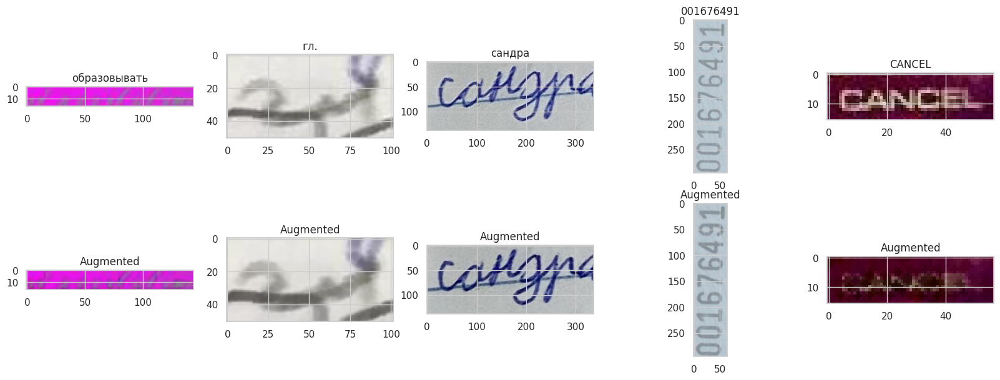

In [ ]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = cv2.erode(img, kernel, iterations=1)
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

### Dilation

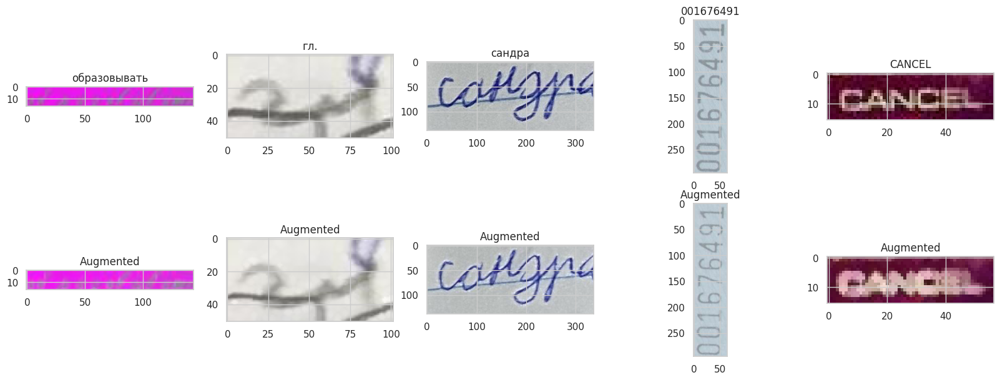

In [ ]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = cv2.dilate(img, kernel, iterations=1)
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

## Noise

### Black drop color

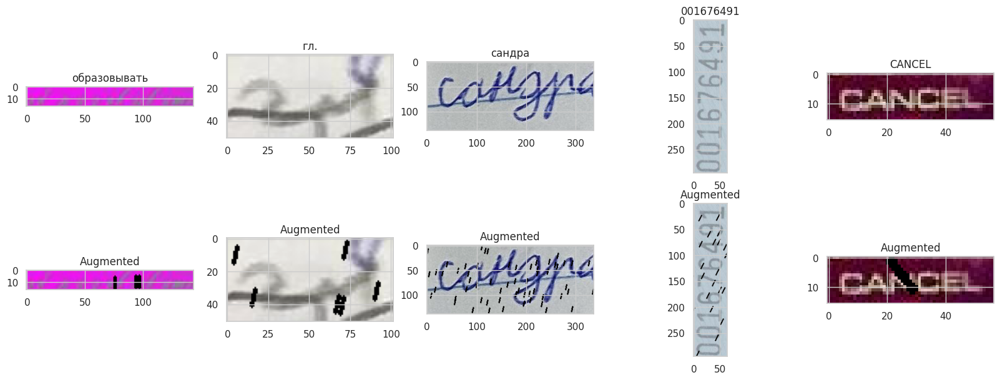

In [ ]:
transform = A.RandomRain(brightness_coefficient=1.0, drop_length=2, drop_width=2, drop_color = (0, 0, 0), blur_value=1, rain_type = 'drizzle', p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

### RandomShadow

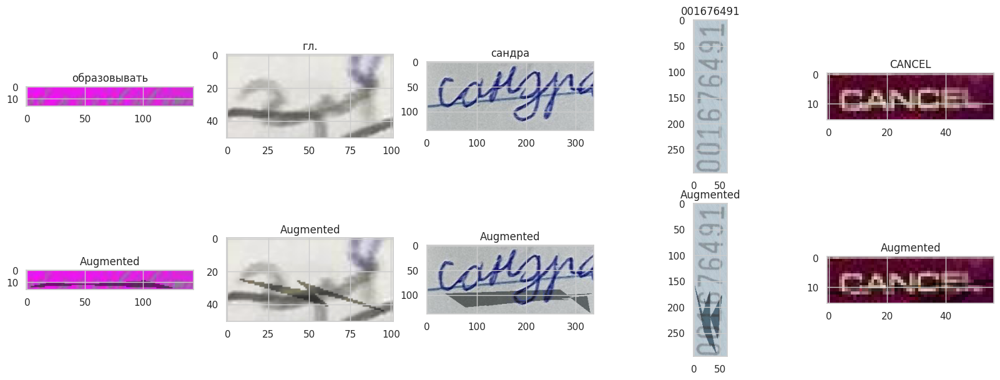

In [ ]:
transform = A.RandomShadow(p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

### PixelDropout

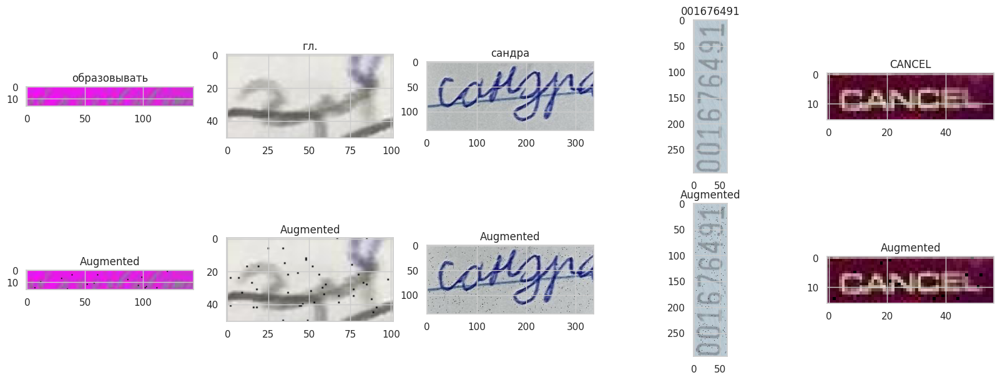

In [ ]:
transform = A.PixelDropout(p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

## ShiftScaleRotate

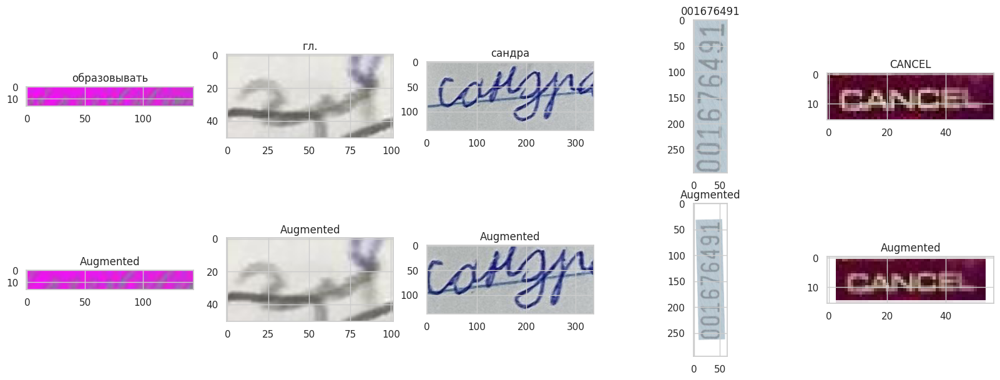

In [ ]:
transform = A.ShiftScaleRotate(shift_limit=0, scale_limit=0.25, rotate_limit=2, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255),p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

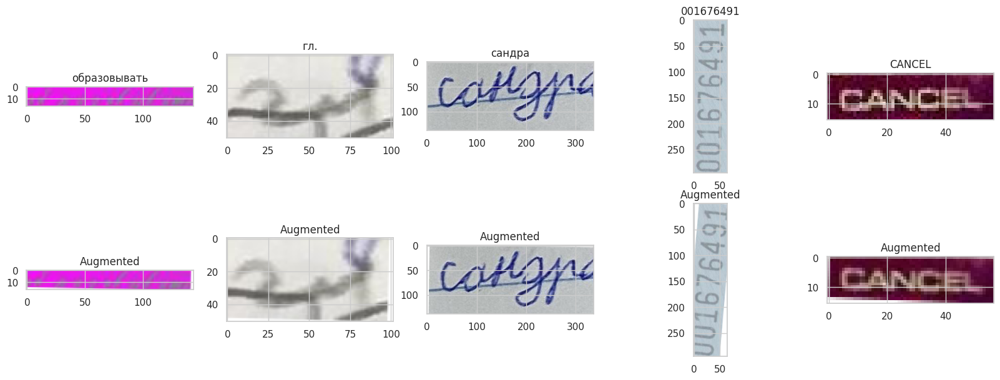

In [ ]:
transform = A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0, rotate_limit=5, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255),p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

## Blur

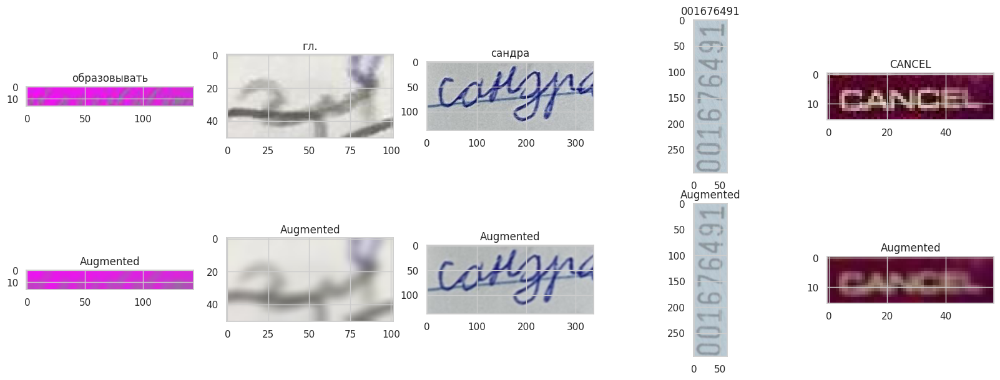

In [ ]:
transform = A.Blur(blur_limit=(3, 7),p=1)
f, ax = plt.subplots(2, 5, figsize=(20, 7))
for idx, row in enumerate(train_df.sample(5, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        img = np.asarray(im)
        img = transform(image=img)['image'] 
        ax[0, idx].imshow(im)
        ax[0, idx].set_title(row.Expected)
        ax[1, idx].imshow(img)
        ax[1, idx].set_title('Augmented')
plt.show()

# Train-Test-Validation split

In [ ]:
TRAIN_SIZE = 0.8

In [ ]:
train_df

,Id,Expected,target_length,language,image_size,image_shape,image_shape_and_language
0,1.jpg,Атырау,6,RUSSIAN,"(303, 77)",horizontal rectangle,horizontal rectangle RUSSIAN
1,2.jpg,транз,5,RUSSIAN,"(128, 58)",horizontal rectangle,horizontal rectangle RUSSIAN
2,3.jpg,ходят,5,RUSSIAN,"(95, 21)",horizontal rectangle,horizontal rectangle RUSSIAN
3,4.jpg,"ощущений,",9,RUSSIAN,"(146, 45)",horizontal rectangle,horizontal rectangle RUSSIAN
4,5.jpg,74,2,digits,"(38, 48)",square,square digits
...,...,...,...,...,...,...,...
275995,275996.jpg,DO,2,ENGLISH,"(49, 29)",square,square ENGLISH
275996,275997.jpg,BASUCC,6,ENGLISH,"(11, 26)",vertical rectangle,vertical rectangle ENGLISH
275997,275998.jpg,"1,120",5,digits,"(44, 18)",horizontal rectangle,horizontal rectangle digits
275998,275999.jpg,"наблюдателей,",13,RUSSIAN,"(98, 22)",horizontal rectangle,horizontal rectangle RUSSIAN


In [ ]:
train_df.head()

,Id,Expected,target_length,language,image_size,image_shape,image_shape_and_language
0,1.jpg,Атырау,6,RUSSIAN,"(303, 77)",horizontal rectangle,horizontal rectangle RUSSIAN
1,2.jpg,транз,5,RUSSIAN,"(128, 58)",horizontal rectangle,horizontal rectangle RUSSIAN
2,3.jpg,ходят,5,RUSSIAN,"(95, 21)",horizontal rectangle,horizontal rectangle RUSSIAN
3,4.jpg,"ощущений,",9,RUSSIAN,"(146, 45)",horizontal rectangle,horizontal rectangle RUSSIAN
4,5.jpg,74,2,digits,"(38, 48)",square,square digits


In [ ]:
train, val_test = train_test_split(train_df, stratify=train_df.image_shape_and_language, train_size=TRAIN_SIZE, random_state=RANDOM_STATE)

In [ ]:
val, test = train_test_split(val_test, stratify=val_test.image_shape, train_size=0.5, random_state=RANDOM_STATE)

In [ ]:
print(f'{len(train)=}, {len(val)=}, {len(test)=}')

len(train)=220800, len(val)=27600, len(test)=27600


In [ ]:
train

,Id,Expected,target_length,language,image_size,image_shape,image_shape_and_language
188875,188876.jpg,ДВА,3,RUSSIAN,"(50, 21)",horizontal rectangle,horizontal rectangle RUSSIAN
74670,74671.jpg,изображением,12,RUSSIAN,"(256, 64)",horizontal rectangle,horizontal rectangle RUSSIAN
89911,89912.jpg,создав,6,RUSSIAN,"(62, 14)",horizontal rectangle,horizontal rectangle RUSSIAN
153838,153839.jpg,"счастья сотворен,",17,RUSSIAN,"(566, 75)",horizontal rectangle,horizontal rectangle RUSSIAN
83492,83493.jpg,или,3,RUSSIAN,"(66, 28)",horizontal rectangle,horizontal rectangle RUSSIAN
...,...,...,...,...,...,...,...
55175,55176.jpg,DURUOM,6,ENGLISH,"(27, 7)",horizontal rectangle,horizontal rectangle ENGLISH
59619,59620.jpg,сла,3,RUSSIAN,"(190, 71)",horizontal rectangle,horizontal rectangle RUSSIAN
164139,164140.jpg,20,2,digits,"(18, 16)",square,square digits
54431,54432.jpg,рощинский,9,RUSSIAN,"(261, 40)",horizontal rectangle,horizontal rectangle RUSSIAN


In [ ]:
mean, std = calculate_mean_and_std(train)

  0%|          | 0/220800 [00:00<?, ?it/s]

In [ ]:
mean, std

(tensor([0.6281, 0.6265, 0.6372]), tensor([0.2869, 0.2823, 0.2838]))

In [ ]:
train.to_csv('train.csv', index=False)
val.to_csv('val.csv', index=False)
test.to_csv('test.csv', index=False)

# Baseline

In [ ]:
max_target_length = 25
max_ctc_length = max_target_length * 3
height_rescale = 100
width_rescale = 300
drop_undefined_language = False
batch_size = 512
epochs = 30

In [ ]:
train_filtered = filter_train_data(train, max_target_length, drop_undefined_language)
train_filtered.shape

(220069, 7)

In [ ]:
id2char = set() 
for string in train_filtered.Expected:
    id2char.update(set(str(string)))
if BLANK_SYMBOL in id2char:
    raise Exception
else:
    id2char = [BLANK_SYMBOL] + list(id2char)

char2id = {id2char[i]: i for i in range(len(id2char))}

In [ ]:
train_transform = A.Compose(
    [
        A.Resize(height=height_rescale, width=width_rescale),
        A.Normalize(mean=mean, std=std),
        ToTensorV2(),
    ]
)

val_transform = A.Compose(
    [
        A.Resize(height=height_rescale, width=width_rescale),
        A.Normalize(mean=mean, std=std),
        ToTensorV2(),
    ]
)

In [ ]:
train_dataset = RecognitionDataset(train_filtered, char2id, transforms=train_transform)
train_dataloader = DataLoader(train_dataset, 
                              batch_size=32, shuffle=True, num_workers=1, pin_memory=True, 
                              drop_last=True, collate_fn=collate_fn)

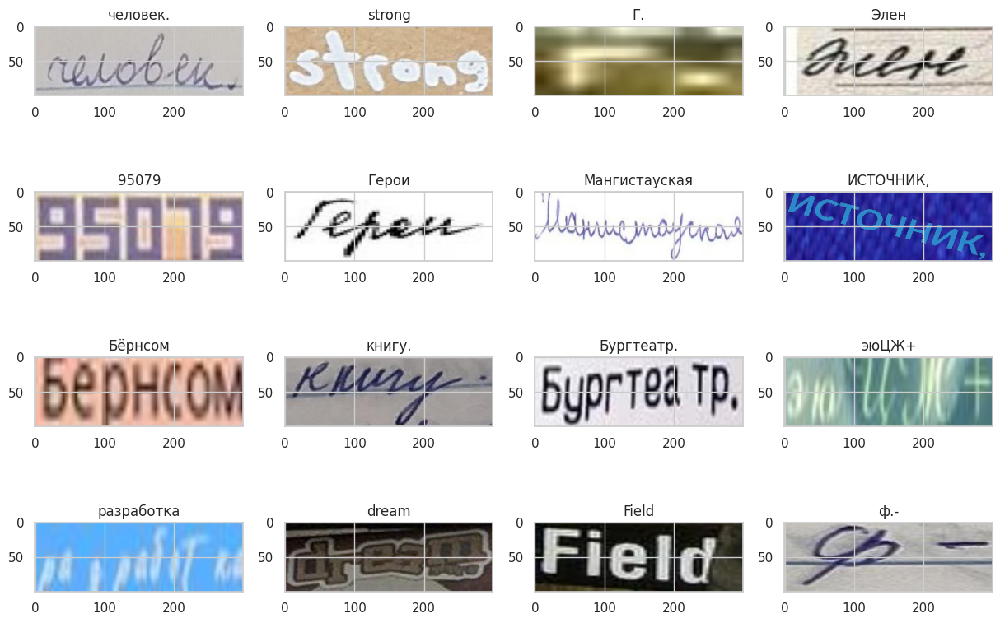

In [ ]:
plot_from_batch_generator(train_dataloader, mean, std)

In [ ]:
class FeatureExtractor(Module):
    
    def __init__(self, input_size=(height_rescale, width_rescale), output_len=max_ctc_length):
        super(FeatureExtractor, self).__init__()
        
        h, w = input_size
        resnet = getattr(models, 'resnet18')(weights='ResNet18_Weights.DEFAULT')
        self.cnn = Sequential(*list(resnet.children())[:-2])
        with torch.no_grad():
            latent_space_width = self.cnn(torch.randn(size=(10, 3, height_rescale, width_rescale))).shape[3]
        
        self.pool = AdaptiveAvgPool2d((1, latent_space_width))  
        self.proj = Conv2d(latent_space_width, output_len, kernel_size=1)
  
        self.num_output_features = self.cnn[-1][-1].bn2.num_features    
    
    def apply_projection(self, x):
        """Use convolution to increase width of a features.
        
        Args:
            - x: Tensor of features (shaped B x C x H x W).
            
        Returns:
            New tensor of features (shaped B x C x H x W').
        """
        x = x.permute(0, 3, 2, 1).contiguous()
        x = self.proj(x)
        x = x.permute(0, 2, 3, 1).contiguous()
        
        return x
   
    def forward(self, x):
        # Apply conv layers
        features = self.cnn(x)
        
        # Pool to make height == 1
        features = self.pool(features)
        
        # Apply projection to increase width
        features = self.apply_projection(features)
        
        return features

In [ ]:
class SequencePredictor(Module):
    
    def __init__(self, input_size, hidden_size, num_layers, num_classes, dropout=0.3, bidirectional=False):
        super(SequencePredictor, self).__init__()
        
        self.num_classes = num_classes        
        self.rnn = GRU(input_size=input_size,
                       hidden_size=hidden_size,
                       num_layers=num_layers,
                       dropout=dropout,
                       bidirectional=bidirectional)
        
        fc_in = hidden_size if not bidirectional else 2 * hidden_size
        self.fc = Linear(in_features=fc_in,
                         out_features=num_classes)
    
    def _init_hidden(self, batch_size):
        """Initialize new tensor of zeroes for RNN hidden state.
        
        Args:
            - batch_size: Int size of batch
            
        Returns:
            Tensor of zeros shaped (num_layers * num_directions, batch, hidden_size).
        """
        num_directions = 2 if self.rnn.bidirectional else 1
        
        # YOUR CODE HERE
        h = torch.zeros(self.rnn.num_layers * num_directions, batch_size, self.rnn.hidden_size)
        # END OF YOUR CODE
        
        return h
        
    def _reshape_features(self, x):
        """Change dimensions of x to fit RNN expected input.
        
        Args:
            - x: Tensor x shaped (B x (C=1) x H x W).
        
        Returns:
            New tensor shaped (W x B x H).
        """
        
        # YOUR CODE HERE
        x = x.squeeze(1)
        x = x.permute(2, 0, 1)
        # END OF YOUR CODE
        
        return x
    
    def forward(self, x):
        x = self._reshape_features(x)
        
        batch_size = x.size(1)
        h_0 = self._init_hidden(batch_size)
        h_0 = h_0.to(x.device)
        x, _ = self.rnn(x, h_0)
        
        x = self.fc(x)
        return x

In [ ]:
class CRNN(Module):
    
    def __init__(self, num_classes=len(id2char),
                 cnn_input_size=(height_rescale, width_rescale), cnn_output_len=max_ctc_length,
                 rnn_hidden_size=128, rnn_num_layers=2, rnn_dropout=0.3, rnn_bidirectional=False):
        super(CRNN, self).__init__()
        self.features_extractor = FeatureExtractor(input_size=cnn_input_size, output_len=cnn_output_len)
        self.sequence_predictor = SequencePredictor(input_size=self.features_extractor.num_output_features,
                                                    hidden_size=rnn_hidden_size, num_layers=rnn_num_layers,
                                                    num_classes=num_classes, dropout=rnn_dropout,
                                                    bidirectional=rnn_bidirectional)
    
    def forward(self, x):
        features = self.features_extractor(x)
        sequence = self.sequence_predictor(features)
        return sequence

In [ ]:
crnn = CRNN()

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 180MB/s]


In [ ]:
x = torch.randn(2, 3, height_rescale, width_rescale)
y = crnn(x)
assert y.size() == (max_ctc_length, 2, len(id2char))

In [ ]:
class ResNet18(pl.LightningModule):
    def __init__(self, id2char):
        super().__init__()
        self.model = CRNN()
        self.id2char = id2char

        self.loss_fn = CTCLoss()
        self.lr = 0.01

    def forward(self, x):
        return self.model(x)

    def step(self, batch, batch_idx, stage):
        logits = self.forward(batch['image']).cpu()
        log_probs = log_softmax(logits, dim=2)
        seq_lens_pred = torch.Tensor([logits.size(0)] * logits.size(1)).int()
        loss = self.loss_fn(
            log_probs=log_probs,
            targets=batch['seq'].cpu(),
            input_lengths=seq_lens_pred,
            target_lengths=batch['seq_len'].cpu()
        )
        self.log(f'{stage}_loss', loss, on_epoch=True, on_step=stage=='train', prog_bar=True)
        metric = self.get_mean_edit_distance(logits, batch['text'])
        self.log(f'{stage}_metric', metric, on_epoch=True,  on_step=False, prog_bar=True)
        return loss

    def training_step(self, batch, batch_idx):
        return self.step(batch, batch_idx, "train")
    
    def validation_step(self, batch, batch_idx):
        return self.step(batch, batch_idx, "val")

    def test_step(self, batch, batch_idx):
        return self.step(batch, batch_idx, "test")

    def predict_step(self, batch, batch_idx, dataloader_idx=0):
        logits = self.forward(batch['image']).cpu()
        texts_preds = decode(logits, self.id2char)
        return texts_preds

    def get_mean_edit_distance(self, logits, texts):
        texts_preds = decode(logits, self.id2char)
        res = 0
        for text_pred, text_real in zip(texts_preds, texts):
            res += edit_distance(text_pred, text_real)
        return res / len(texts_preds)

    def configure_optimizers(self):
        optimizer = torch.optim.AdamW(self.parameters(), lr=self.lr)
        scheduler = torch.optim.lr_scheduler.OneCycleLR(
            optimizer,
            max_lr=0.25,
            epochs=epochs,
            steps_per_epoch=len(train_filtered) // batch_size
        )

        return [optimizer], [scheduler]

In [ ]:
train_dataset = RecognitionDataset(train_filtered, char2id, transforms=train_transform)
train_dataloader = DataLoader(train_dataset,
                              batch_size=batch_size, shuffle=True, num_workers=12, pin_memory=True, 
                              drop_last=True, collate_fn=collate_fn)

val_dataset = RecognitionDataset(val, char2id, transforms=val_transform)
val_dataloader = DataLoader(val_dataset,
                              batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                              drop_last=False, collate_fn=collate_fn)

test_dataset = RecognitionDataset(test, char2id, transforms=val_transform)
test_dataloader = DataLoader(test_dataset,
                              batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                              drop_last=False, collate_fn=collate_fn)

In [ ]:
# del model
# del trainer
torch.cuda.empty_cache()
import gc
gc.collect()

122138

In [ ]:
model = ResNet18(id2char)
logger = pl.loggers.TensorBoardLogger(save_dir='.', version="Baseline")
early_stopping = EarlyStopping(monitor="val_metric", mode="min", patience=3)

trainer = pl.Trainer(max_epochs=epochs, accelerator="gpu", devices=-1, logger=logger, callbacks=[early_stopping])
trainer.fit(model, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name    | Type    | Params
------------------------------------
0 | model   | CRNN    | 11.6 M
1 | loss_fn | CTCLoss | 0     
----------

Sanity Checking: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:430: PossibleUserWarning: The dataloader, val_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 12 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/utilities/data.py:76: UserWarning: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 512. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.
  warning_cache.warn(
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:430: PossibleUserWarning: The dataloader, train_dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 12 which is the number of cpus on this machine) in th

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/utilities/data.py:76: UserWarning: Trying to infer the `batch_size` from an ambiguous collection. The batch size we found is 464. To avoid any miscalculations, use `self.log(..., batch_size=batch_size)`.
  warning_cache.warn(


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Epoch 00016: reducing learning rate of group 0 to 1.0000e-04.


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Epoch 00020: reducing learning rate of group 0 to 1.0000e-05.


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/call.py:54: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


In [ ]:
trainer.test(dataloaders=test_dataloader)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/checkpoint_connector.py:148: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `.test(ckpt_path='best')` to use the best model or `.test(ckpt_path='last')` to use the last model. If you pass a value, this warning will be silenced.
  rank_zero_warn(
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./lightning_logs/Baseline/checkpoints/epoch=21-step=9438.ckpt
INFO:pytorch_lightning.accelerators

Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    1.4664925336837769     │
│        test_metric        │    1.9979348182678223     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1.4664925336837769, 'test_metric': 1.9979348182678223}]

In [ ]:
import os

pred_df = pd.DataFrame({
    'Id': os.listdir('/content/dataset/test/test/'),
    'Expected': ['text'] * len(os.listdir('/content/dataset/test/test/'))
})

In [ ]:
pred_dataset = RecognitionDataset(pred_df, char2id, folder='dataset/test/test', transforms=val_transform)
pred_dataloader = DataLoader(pred_dataset,
                          batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                          drop_last=False, collate_fn=collate_fn)

In [ ]:
prediction = trainer.predict(dataloaders=pred_dataloader)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/checkpoint_connector.py:148: UserWarning: `.predict(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `.predict(ckpt_path='best')` to use the best model or `.predict(ckpt_path='last')` to use the last model. If you pass a value, this warning will be silenced.
  rank_zero_warn(
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./lightning_logs/Baseline/checkpoints/epoch=21-step=9438.ckpt
INFO:pytorch_lightning.acc

Predicting: 0it [00:00, ?it/s]

In [ ]:
prediction = pd.DataFrame(
    {
        'Id': pred_df['Id'],
        'Predicted': [item for sublist in prediction for item in sublist]
    }
)

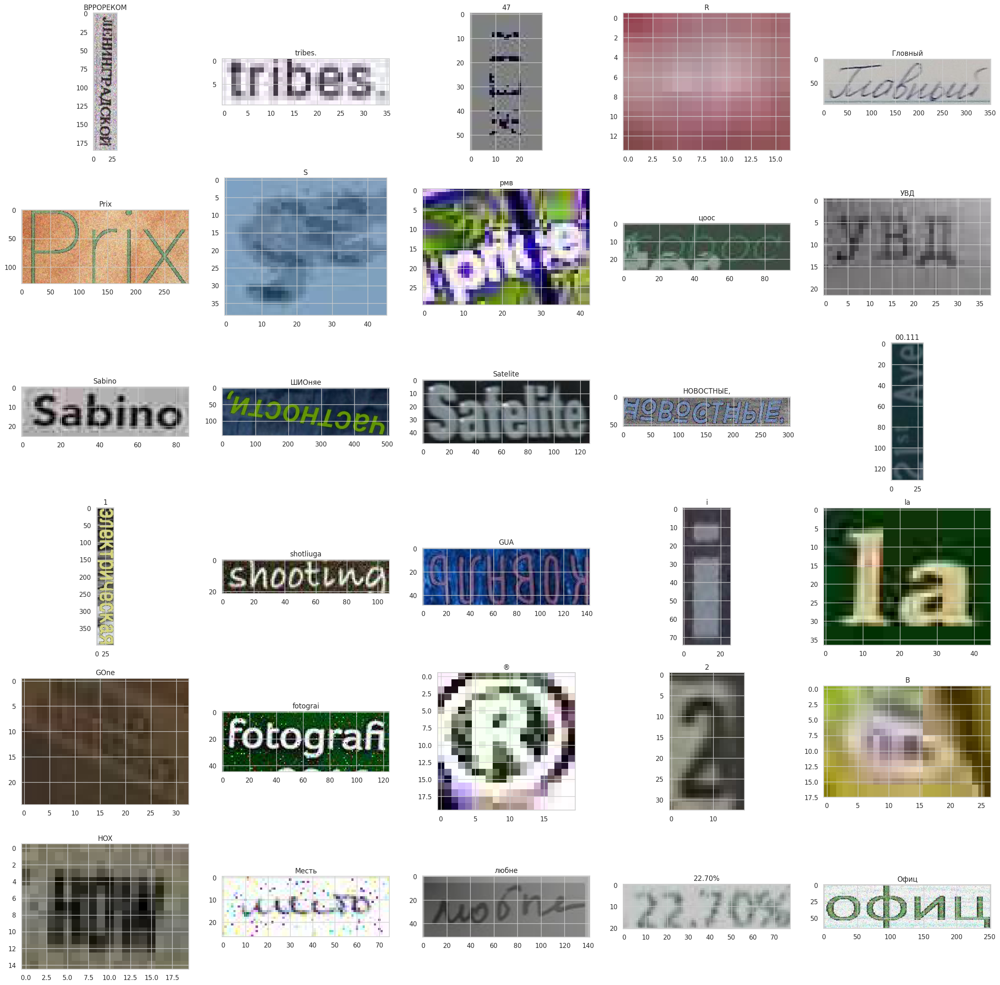

In [ ]:
f, ax = plt.subplots(6, 5, figsize=(30, 30))
for idx, row in enumerate(prediction.sample(30, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/test/test/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(row.Predicted)
plt.show()

In [ ]:
prediction.to_csv('pred.csv', index=False)

## Results evaluation

In [ ]:
val_dataset = RecognitionDataset(val, char2id, transforms=val_transform)
val_dataloader = DataLoader(val_dataset,
                              batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                              drop_last=False, collate_fn=collate_fn)

In [ ]:
prediction = trainer.predict(dataloaders=val_dataloader)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/connectors/checkpoint_connector.py:148: UserWarning: `.predict(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `.predict(ckpt_path='best')` to use the best model or `.predict(ckpt_path='last')` to use the last model. If you pass a value, this warning will be silenced.
  rank_zero_warn(
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./lightning_logs/Baseline/checkpoints/epoch=21-step=9438.ckpt
INFO:pytorch_lightning.acc

Predicting: 0it [00:00, ?it/s]

In [ ]:
val['Predicted'] = [item for sublist in prediction for item in sublist]

In [ ]:
val['edit_distance'] = val.apply(lambda x: edit_distance(str(x['Expected']), str(x['Predicted'])), axis=1)

In [ ]:
val.head()

,Id,Expected,target_length,language,image_size,image_shape,image_shape_and_language,Predicted,edit_distance
193161,193162.jpg,Карагандинская обл,18,RUSSIAN,"(769, 114)",horizontal rectangle,horizontal rectangle RUSSIAN,Кркуенася б,11
171061,171062.jpg,Льет печально,13,RUSSIAN,"(427, 72)",horizontal rectangle,horizontal rectangle RUSSIAN,льет печально,1
233726,233727.jpg,WESTIN,6,ENGLISH,"(307, 134)",horizontal rectangle,horizontal rectangle ENGLISH,WESTIN,0
28142,28143.jpg,3,1,digits,"(13, 18)",square,square digits,3,0
118389,118390.jpg,Тернеровской,12,RUSSIAN,"(274, 50)",horizontal rectangle,horizontal rectangle RUSSIAN,ТЕРНЕРОВСКОЙ,11


In [ ]:
val.groupby('image_shape')['edit_distance'].mean()

image_shape
horizontal rectangle    2.047189
square                  1.200886
vertical rectangle      5.541176
Name: edit_distance, dtype: float64

Bad predictions for vertical images

In [ ]:
val.groupby('language')['edit_distance'].mean()

language
ENGLISH      2.179728
RUSSIAN      1.911160
digits       1.634452
undefined    5.583333
Name: edit_distance, dtype: float64

Bad predictions for undefined language images

In [ ]:
val[['target_length', 'edit_distance']].corr()

,target_length,edit_distance
target_length,1.000000,0.600839
edit_distance,0.600839,1.000000


In [ ]:
val['edit_distance_normalized'] = val.apply(lambda x: x['edit_distance'] / x['target_length'], axis=1)
val[['target_length', 'edit_distance_normalized']].corr()

,target_length,edit_distance_normalized
target_length,1.000000,0.046486
edit_distance_normalized,0.046486,1.000000


There is no correlation between model perfomance and text length

In [ ]:
val.groupby('image_shape_and_language')['edit_distance'].mean()

image_shape_and_language
horizontal rectangle ENGLISH      2.658871
horizontal rectangle RUSSIAN      1.874344
horizontal rectangle digits       2.119663
horizontal rectangle undefined    5.600000
square ENGLISH                    1.281458
square RUSSIAN                    1.581259
square digits                     0.623256
square undefined                  5.500000
vertical rectangle ENGLISH        5.432000
vertical rectangle RUSSIAN        6.003344
vertical rectangle digits         5.054688
Name: edit_distance, dtype: float64

In [ ]:
val['image_square'] = val['image_size'].apply(lambda x: x[0] * x[1])

In [ ]:
val[['image_square', 'edit_distance']].corr()

,image_square,edit_distance
image_square,1.000000,0.038615
edit_distance,0.038615,1.000000


There is no correlation between model perfomance and original image size

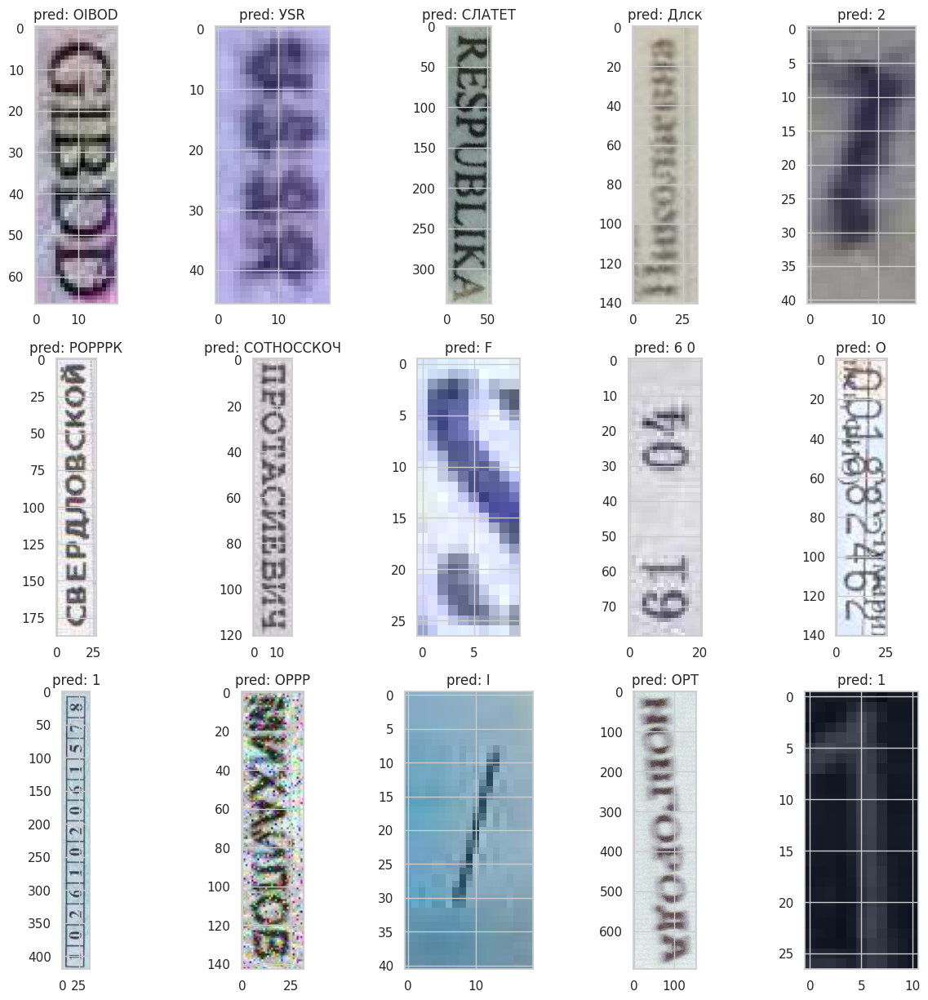

In [ ]:
f, ax = plt.subplots(3, 5, figsize=(15, 15))
for idx, row in enumerate(val[val.image_shape.eq('vertical rectangle')].sample(15, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(f'pred: {row.Predicted}')
plt.show()

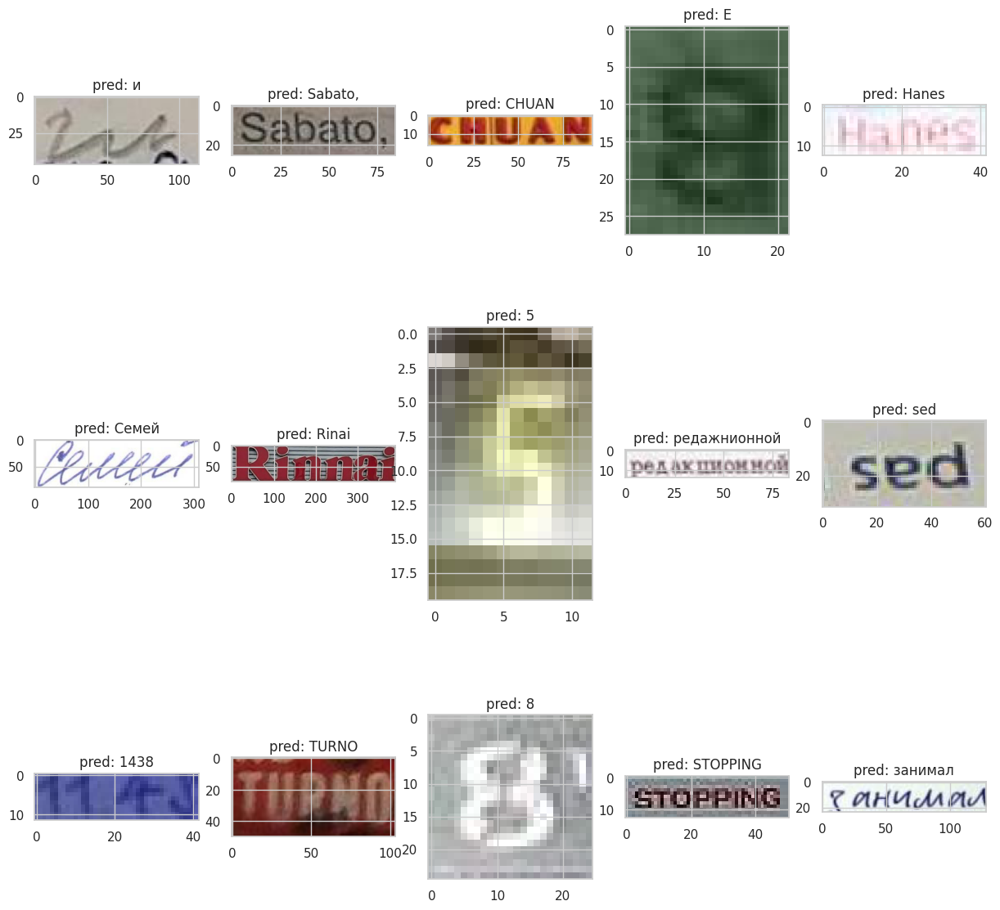

In [ ]:
f, ax = plt.subplots(3, 5, figsize=(15, 15))
for idx, row in enumerate(val[~val.image_shape.eq('vertical rectangle')].sample(15, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(f'pred: {row.Predicted}')
plt.show()

Conclusions:


1.   Crucial: find an approach for vertical images
2.   Good to have: find an approach for indefined languages
3. Given train metric: 0.8 and val_metric: 1.9, looks like we are overfitted - add augmentations



# Augmentation pipeline

In [ ]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
def make_erode(img, kernel=kernel, *args, **kwargs):
    return cv2.erode(img, kernel, iterations=1)

def make_dilate(img, kernel=kernel, *args, **kwargs):
    return cv2.dilate(img, kernel, iterations=1)

In [ ]:
augmentations = A.Compose([A.OneOf([
    #morphological alterations
    A.OneOf([
        A.Lambda(name='erode', image=make_erode, p=0.15),
        A.Lambda(name='dilate', image=make_dilate, p=0.2),
    ], p=0.9),

    A.OneOf([
        #add black pixels noise
        A.OneOf([
            A.RandomRain(brightness_coefficient=1.0, drop_length=2, drop_width=2, drop_color = (0, 0, 0), blur_value=1, rain_type = 'drizzle', p=0.05),
            A.RandomShadow(p=1),
            A.PixelDropout(p=1),
        ], p=0.9),

        #add white pixels noise
        A.OneOf([
            A.PixelDropout(dropout_prob=0.5,drop_value=255,p=1),
            A.RandomRain(brightness_coefficient=1.0, drop_length=2, drop_width=2, drop_color = (255, 255, 255), blur_value=1, rain_type = None, p=1), 
        ], p=0.9),
    ], p=1),

    #transformations
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0, rotate_limit=5, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), p=0.5),

    #Blur
    A.Blur(blur_limit=(3, 7),p=0.25),
    ], p=0.75)
])

In [ ]:
transform = A.Compose([
    A.Resize(height=100, width=300),
    augmentations,
    A.Normalize(mean=mean, std=std),
    ToTensorV2(),
])

In [ ]:
train_dataset = RecognitionDataset(train, char2id, transforms=transform)
train_dataloader = DataLoader(train_dataset, 
                              batch_size=32, shuffle=True, num_workers=1, pin_memory=True, 
                              drop_last=True, collate_fn=collate_fn)

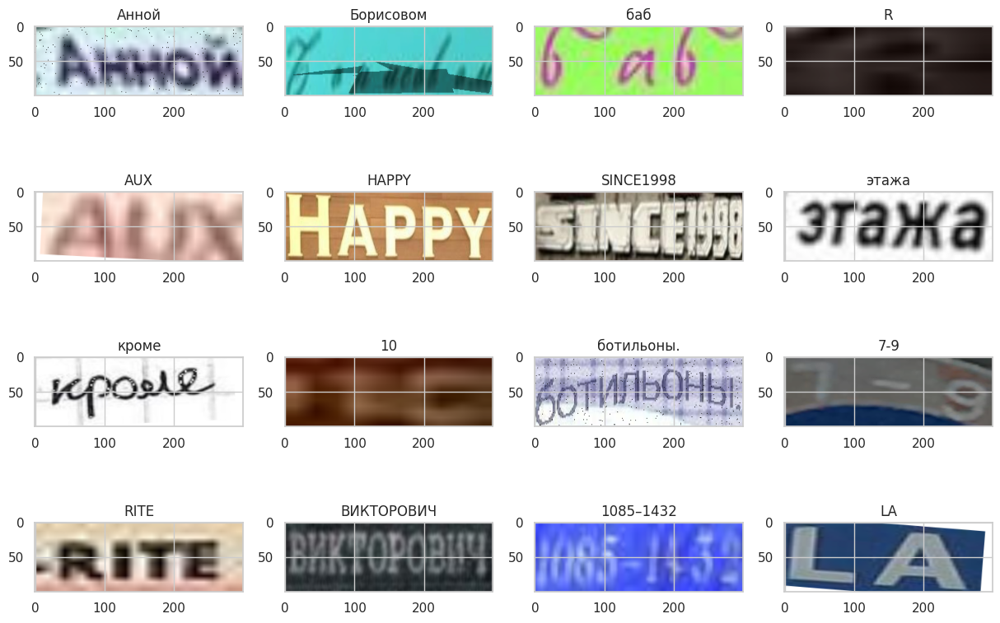

In [ ]:
plot_from_batch_generator(train_dataloader, mean, std)

# PARSeq

In [ ]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
def make_erode(img, kernel=kernel, *args, **kwargs):
    return cv2.erode(img, kernel, iterations=1)

def make_dilate(img, kernel=kernel, *args, **kwargs):
    return cv2.dilate(img, kernel, iterations=1)

In [ ]:
augmentations = A.Compose([A.OneOf([
    #morphological alterations
    A.OneOf([
        A.Lambda(name='erode', image=make_erode, p=0.15),
        A.Lambda(name='dilate', image=make_dilate, p=0.2),
    ], p=0.9),

    A.OneOf([
        #add black pixels noise
        A.OneOf([
            A.RandomRain(brightness_coefficient=1.0, drop_length=2, drop_width=2, drop_color = (0, 0, 0), blur_value=1, rain_type = 'drizzle', p=0.05),
            A.RandomShadow(p=1),
            A.PixelDropout(p=1),
        ], p=0.9),

        #add white pixels noise
        A.OneOf([
            A.PixelDropout(dropout_prob=0.5,drop_value=255,p=1),
            A.RandomRain(brightness_coefficient=1.0, drop_length=2, drop_width=2, drop_color = (255, 255, 255), blur_value=1, rain_type = None, p=1), 
        ], p=0.9),
    ], p=1),

    #transformations
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0, rotate_limit=5, border_mode=cv2.BORDER_CONSTANT, value=(255,255,255), p=0.5),

    #Blur
    A.Blur(blur_limit=(3, 7),p=0.25),
    ], p=0.75)
])

In [ ]:
train = pd.read_csv('train.csv')
val = pd.read_csv('val.csv')
test = pd.read_csv('test.csv')

In [ ]:
mean, std = calculate_mean_and_std(train)

  0%|          | 0/220800 [00:00<?, ?it/s]

In [ ]:
parseq = torch.hub.load('baudm/parseq', 'parseq', pretrained=True)

Using cache found in /root/.cache/torch/hub/baudm_parseq_main


In [ ]:
max_target_length = 25
batch_size = 384
height_rescale = 32
width_rescale = 128
drop_undefined_language = False
epochs = 30

In [ ]:
train_filtered = filter_train_data(train, max_target_length, drop_undefined_language)

In [ ]:
id2char = set()
for string in train_filtered.Expected:
    id2char.update(set(str(string)))

In [ ]:
train_transform = A.Compose([
    A.Resize(height=height_rescale, width=width_rescale),
    augmentations,
    A.Normalize(mean=mean, std=std),
    ToTensorV2(),
])

In [ ]:
val_transform = A.Compose([
    A.Resize(height=height_rescale, width=width_rescale),
    A.Normalize(mean=mean, std=std),
    ToTensorV2(),
])

In [ ]:
class PARSeq(pl.LightningModule):
    def __init__(self):
        super().__init__()
        
        self.model = torch.hub.load('baudm/parseq', 'parseq', pretrained=True)
        self.model.batch_size = batch_size
        self.model.max_label_length = max_target_length
        self._change_tokenizer()
        self.model.head = Linear(self.model.head.in_features, len(self.model.tokenizer) - 2)
        self._change_text_embed()
        self.model.pos_queries = torch.nn.Parameter(torch.Tensor(1, self.model.max_label_length + 1, self.model.text_embed.embedding.embedding_dim))
        torch.nn.init.trunc_normal_(self.model.pos_queries, std=.02)

    def forward(self, images, max_length=None):
        return self.model.forward(images, max_length)

    def training_step(self, batch, batch_idx):
        return self.model.training_step(batch, batch_idx)

    def _eval_step(self, batch, stage):
        images, labels = batch

        metric = 0
        logits = self.forward(images)
        probs = logits.softmax(-1)
        preds, probs = self.model.tokenizer.decode(probs)
        for pred, gt in zip(preds, labels):
            metric += edit_distance(pred, gt)
        metric /= len(labels)
        self.log(f'{stage}_metric', metric, on_epoch=True,  on_step=False, prog_bar=True)
        return None

    def validation_step(self, batch, batch_idx):
        return self._eval_step(batch, 'val')

    def test_step(self, batch, batch_idx):
        return self._eval_step(batch, 'train')

    def predict_step(self, batch, batch_idx, dataloader_idx=0):
        logits = self.forward(batch[0])
        probs = logits.softmax(-1)
        preds, probs = self.model.tokenizer.decode(probs)
        return preds

    def _change_tokenizer(self):
        self.model.tokenizer._itos = self.model.tokenizer._itos[:-2]
        last_id = len(self.model.tokenizer._itos) - 1
        for my_token in id2char:
            if my_token in (self.model.tokenizer.EOS, self.model.tokenizer.BOS, self.model.tokenizer.PAD):
                raise Exception
            if my_token not in self.model.tokenizer._stoi:
                self.model.tokenizer._itos += (my_token, )
                last_id += 1
                self.model.tokenizer._stoi[my_token] = last_id
        for token in (self.model.tokenizer.BOS, self.model.tokenizer.PAD):
            self.model.tokenizer._itos += (token, )
            last_id += 1
            self.model.tokenizer._stoi[token] = last_id

        self.model.tokenizer.bos_id = self.model.tokenizer._stoi[self.model.tokenizer.BOS]
        self.model.tokenizer.pad_id = self.model.tokenizer._stoi[self.model.tokenizer.PAD]

        self.model.bos_id = self.model.tokenizer.bos_id
        self.model.pad_id = self.model.tokenizer.pad_id

    def _change_text_embed(self):
        existing_weight = self.model.text_embed.embedding.weight
        new_weights = torch.empty(len(self.model.tokenizer), self.model.text_embed.embedding.embedding_dim)
        torch.nn.init.xavier_uniform_(new_weights)
        new_weights[:existing_weight.size(0) - 2] = existing_weight[:-2]
        new_weights[-2:] = existing_weight[-2:]

        self.model.text_embed.embedding = Embedding(num_embeddings=len(self.model.tokenizer), embedding_dim=self.model.text_embed.embedding.embedding_dim, _weight=new_weights)

    def configure_optimizers(self):
        agb = self.trainer.accumulate_grad_batches
        # Linear scaling so that the effective learning rate is constant regardless of the number of GPUs used with DDP.
        lr_scale = agb * np.sqrt(self.trainer.num_devices) * self.model.batch_size / 256.
        lr = lr_scale * self.model.lr
        optim = create_optimizer_v2(self.model, 'adamw', lr, self.model.weight_decay)
        sched = torch.optim.lr_scheduler.OneCycleLR(optim, lr, self.trainer.estimated_stepping_batches, pct_start=self.model.warmup_pct,
                           cycle_momentum=False)
        return {'optimizer': optim, 'lr_scheduler': {'scheduler': sched, 'interval': 'step'}}

    def optimizer_zero_grad(self, *args, **kwargs):
        self.model.optimizer_zero_grad(*args, **kwargs)

In [ ]:
model = PARSeq()

Using cache found in /root/.cache/torch/hub/baudm_parseq_main


In [ ]:
assert (model.model.tokenizer.bos_id, model.model.tokenizer.pad_id) == (model.model.bos_id, model.model.pad_id)
assert model.model.tokenizer._itos[-2:] == (model.model.tokenizer.BOS, model.model.tokenizer.PAD)

In [ ]:
class RecognitionDataset(Dataset):

    def __init__(self, df, folder='dataset/train/train', transforms=None):
        super(RecognitionDataset, self).__init__()
        self.df = df
        self.image_names = df['Id'].to_list()
        self.texts = df['Expected'].to_list()
        self.transforms = transforms
        self.folder = folder

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, item):
        image = cv2.imread(f'{self.folder}/{self.image_names[item]}')
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        if self.transforms is not None:
            image = self.transforms(image=image)["image"]
        text = ''.join([i for i in str(self.texts[item]) if i in id2char])
        return image, text

In [ ]:
train_dataset = RecognitionDataset(train_filtered, transforms=train_transform)
train_dataloader = DataLoader(train_dataset,
                              batch_size=batch_size, shuffle=True, num_workers=12, pin_memory=True, 
                              drop_last=True)

val_dataset = RecognitionDataset(val, transforms=val_transform)
val_dataloader = DataLoader(val_dataset,
                              batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                              drop_last=False)

test_dataset = RecognitionDataset(test, transforms=val_transform)
test_dataloader = DataLoader(test_dataset,
                              batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                              drop_last=False)

In [ ]:
# del model
# del trainer
# import torch
# torch.cuda.empty_cache()
# import gc
# gc.collect()

In [ ]:
logger = pl.loggers.TensorBoardLogger(save_dir='.', version="PARSeq")
early_stopping = EarlyStopping(monitor="val_metric", mode="min", patience=3)

trainer = pl.Trainer(max_epochs=epochs, accelerator="gpu", devices=-1, logger=logger, callbacks=[early_stopping])
trainer.fit(model, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True, used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:611: UserWarning: Checkpoint directory ./lightning_logs/PARSeq/checkpoints exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")
INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loading `train_dataloader` to estimate number of stepping batches.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type   | Params
---------------------------------
0 | model | PARSeq | 24.2 M
---------------------------------
24.2 M    Trainable params
0         Non-trainable par

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/core/lightning.py:374: UserWarning: You are trying to `self.log()` but the `self.trainer` reference is not registered on the model yet. This is most likely because the model hasn't been passed to the `Trainer`
  rank_zero_warn(


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=lightning_logs/

<IPython.core.display.Javascript object>

In [ ]:
trainer.test(dataloaders=test_dataloader)

/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/trainer.py:1446: UserWarning: `.test(ckpt_path=None)` was called without a model. The best model of the previous `fit` call will be used. You can pass `test(ckpt_path='best')` to use and best model checkpoint and avoid this warning or `ckpt_path=trainer.checkpoint_callback.last_model_path` to use the last model.
  rank_zero_warn(
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at ./lightning_logs/PARSeq/checkpoints/epoch=29-step=17190.ckpt
INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.utilities.rank_zero:Loaded model weights from checkpoint at ./lightning_logs/PARSeq/checkpoints/epoch=29-step=17190.ckpt


Testing: 0it [00:00, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│       train_metric        │    0.7511594295501709     │
└───────────────────────────┴───────────────────────────┘

[{'train_metric': 0.7511594295501709}]

In [ ]:
pred_df = pd.DataFrame({
    'Id': os.listdir('/content/dataset/test/test/'),
    'Expected': ['text'] * len(os.listdir('/content/dataset/test/test/'))
})

In [ ]:
pred_dataset = RecognitionDataset(pred_df, folder='dataset/test/test', transforms=val_transform)
pred_dataloader = DataLoader(pred_dataset,
                          batch_size=batch_size, shuffle=False, num_workers=12, pin_memory=True, 
                          drop_last=False)

In [ ]:
model = PARSeq.load_from_checkpoint('lightning_logs/PARSeq/checkpoints/epoch=29-step=17190.ckpt')
trainer = pl.Trainer(accelerator="gpu")

Using cache found in /root/.cache/torch/hub/baudm_parseq_main
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True, used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
prediction = trainer.predict(model, dataloaders=pred_dataloader)

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 0it [00:00, ?it/s]

In [ ]:
prediction = pd.DataFrame(
    {
        'Id': pred_df['Id'],
        'Predicted': [item for sublist in prediction for item in sublist]
    }
)

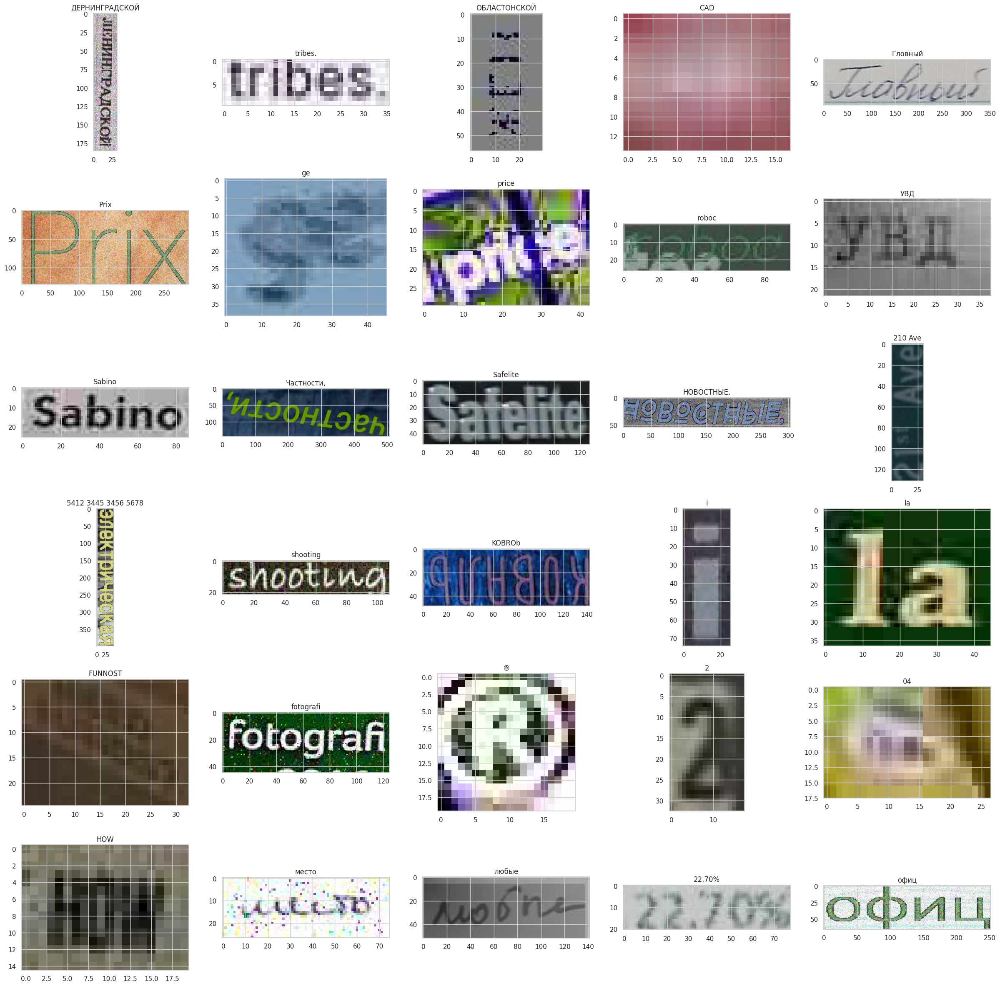

In [ ]:
f, ax = plt.subplots(6, 5, figsize=(30, 30))
for idx, row in enumerate(prediction.sample(30, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/test/test/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(row.Predicted)
plt.show()

In [ ]:
prediction.to_csv('pred.csv', index=False)

## Evaluation results

In [ ]:
prediction = trainer.predict(model, dataloaders=val_dataloader)

INFO:pytorch_lightning.accelerators.gpu:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: 0it [00:00, ?it/s]

In [ ]:
val['Predicted'] = [item for sublist in prediction for item in sublist]

In [ ]:
val['edit_distance'] = val.apply(lambda x: edit_distance(str(x['Expected']), str(x['Predicted'])), axis=1)

In [ ]:
val.head()

,Id,Expected,target_length,language,image_size,image_shape,image_shape_and_language,Predicted,edit_distance
0,193162.jpg,Карагандинская обл,18,RUSSIAN,"(769, 114)",horizontal rectangle,horizontal rectangle RUSSIAN,Карагандинская обя,1
1,171062.jpg,Льет печально,13,RUSSIAN,"(427, 72)",horizontal rectangle,horizontal rectangle RUSSIAN,Льет печально,0
2,233727.jpg,WESTIN,6,ENGLISH,"(307, 134)",horizontal rectangle,horizontal rectangle ENGLISH,WESTIN,0
3,28143.jpg,3,1,digits,"(13, 18)",square,square digits,3,0
4,118390.jpg,Тернеровской,12,RUSSIAN,"(274, 50)",horizontal rectangle,horizontal rectangle RUSSIAN,тернеровской,1


In [ ]:
val.groupby('image_shape')['edit_distance'].mean()

image_shape
horizontal rectangle    0.714244
square                  0.562480
vertical rectangle      2.142647
Name: edit_distance, dtype: float64

In [ ]:
val.groupby('language')['edit_distance'].mean()

language
ENGLISH      0.872617
RUSSIAN      0.702416
digits       0.472577
undefined    7.083333
Name: edit_distance, dtype: float64

In [ ]:
val['edit_distance_normalized'] = val.apply(lambda x: x['edit_distance'] / x['target_length'], axis=1)
val[['target_length', 'edit_distance_normalized']].corr()

,target_length,edit_distance_normalized
target_length,1.000000,-0.040067
edit_distance_normalized,-0.040067,1.000000


In [ ]:
val.groupby('image_shape_and_language')['edit_distance'].mean()

image_shape_and_language
horizontal rectangle ENGLISH      0.987799
horizontal rectangle RUSSIAN      0.669087
horizontal rectangle digits       0.448315
horizontal rectangle undefined    7.600000
square ENGLISH                    0.626029
square RUSSIAN                    0.736457
square digits                     0.256395
square undefined                  4.500000
vertical rectangle ENGLISH        2.280000
vertical rectangle RUSSIAN        2.127090
vertical rectangle digits         2.093750
Name: edit_distance, dtype: float64

In [ ]:
def multiply_dimensions(row):
    width, height = map(int, row.strip('()').split(','))
    result = width * height
    return result

In [ ]:
val['image_square'] = val['image_size'].apply(multiply_dimensions)

In [ ]:
val[['image_square', 'edit_distance']].corr()

,image_square,edit_distance
image_square,1.00000,0.03684
edit_distance,0.03684,1.00000


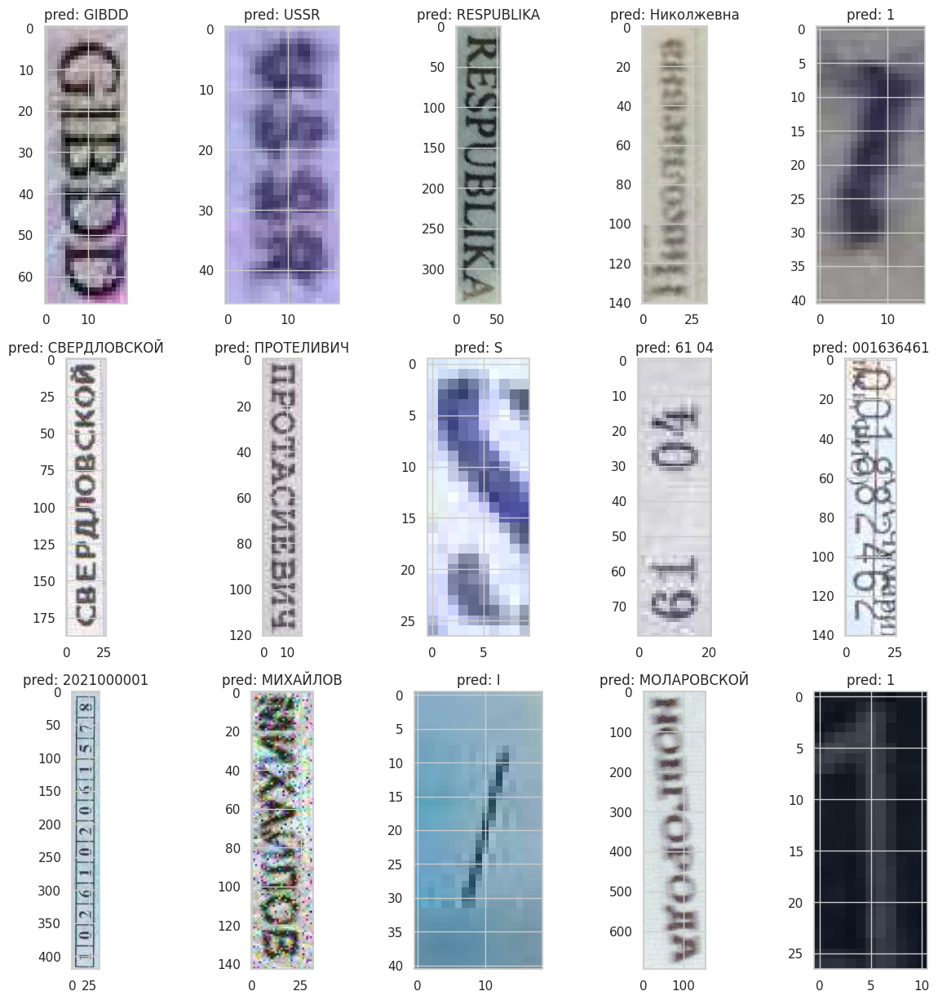

In [ ]:
f, ax = plt.subplots(3, 5, figsize=(15, 15))
for idx, row in enumerate(val[val.image_shape.eq('vertical rectangle')].sample(15, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(f'pred: {row.Predicted}')
plt.show()

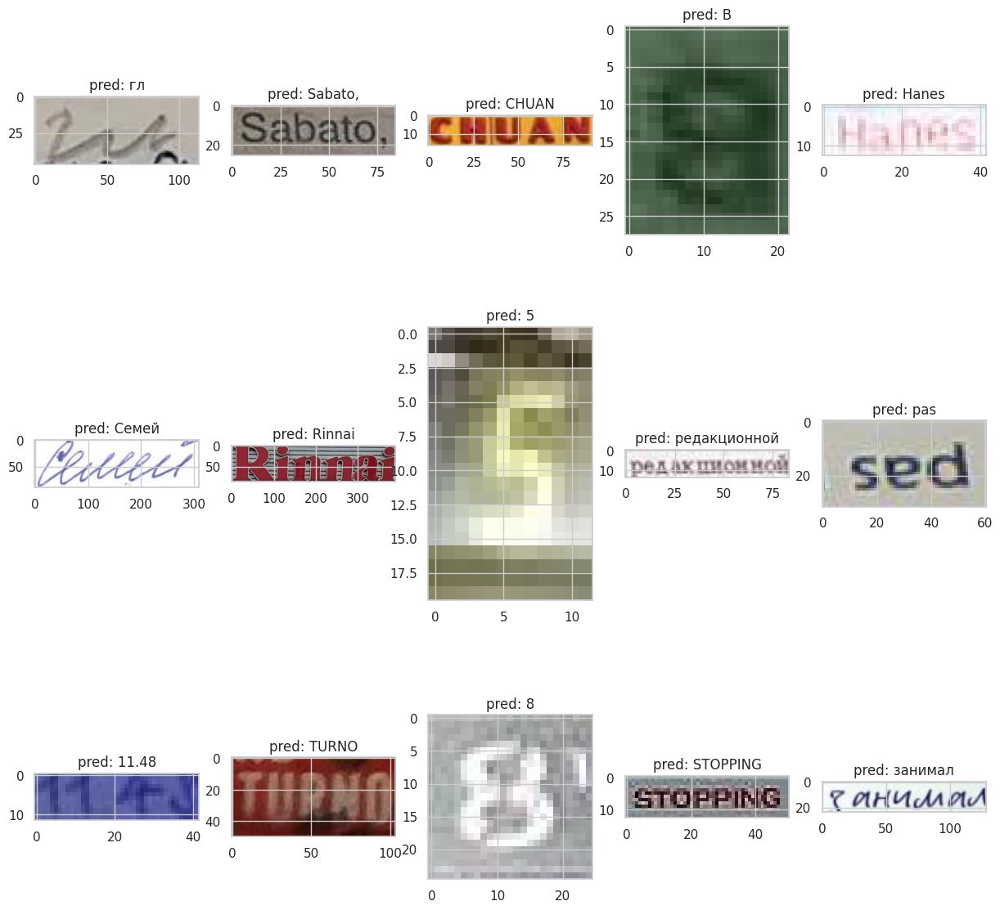

In [ ]:
f, ax = plt.subplots(3, 5, figsize=(15, 15))
for idx, row in enumerate(val[~val.image_shape.eq('vertical rectangle')].sample(15, random_state=RANDOM_STATE).itertuples()):
    with Image.open(f'dataset/train/train/{row.Id}') as im:
        ax[idx // 5, idx % 5].imshow(im)
        ax[idx // 5, idx % 5].set_title(f'pred: {row.Predicted}')
plt.show()